# Part 3: Flow Matching and Score Matching with Gaussian Conditional Probability Paths


### Problem 3.1 Flow Matching with Gaussian Conditional Probability Paths

Recall now that from lecture that our goal is to learn the *marginal vector field* $u_t(x)$ given by $$u_t^{\text{ref}}(x) = \mathbb{E}_{z \sim p_t(z|x)}\left[u_t^{\text{ref}}(x|z)\right].$$
Unfortunately, we don't actually know what $u_t^{\text{ref}}(x)$ is! We will thus approximate $u_t^{\text{ref}}(x)$ as a neural network $u_t^{\theta}(x)$, and exploit the identity $$ u_t^{\text{ref}}(x) = \text{argmin}_{u_t(x)} \,\,\mathbb{E}_{z \sim p_t(z|x)} \left[\lVert u_t(x) - u_t^{\text{ref}}(x|z)\rVert^2\right]$$ to obtain the **conditional flow matching objective**
$$ \mathcal{L}_{\text{CFM}}(\theta) = \,\,\mathbb{E}_{z \sim p(z), x \sim p_t(x|z)} \left[\lVert u_t^{\theta}(x) - u_t^{\text{ref}}(x|z)\rVert^2\right].$$
To model $u_t^{\theta}(x)$, we'll use a simple MLP. This network will take in both $x$ and $t$, and will return the learned vector field $u_t^{\theta}(x)$.

In [ ]:
def build_mlp(dims: List[int], activation: Type[torch.nn.Module] = torch.nn.SiLU):
        mlp = []
        for idx in range(len(dims) - 1):
            mlp.append(torch.nn.Linear(dims[idx], dims[idx + 1]))
            if idx < len(dims) - 2:
                mlp.append(activation())
        return torch.nn.Sequential(*mlp)

class MLPVectorField(torch.nn.Module):
    """
    MLP-parameterization of the learned vector field u_t^theta(x)
    """
    def __init__(self, dim: int, hiddens: List[int]):
        super().__init__()
        self.dim = dim
        self.net = build_mlp([dim + 1] + hiddens + [dim])

    def forward(self, x: torch.Tensor, t: torch.Tensor):
        """
        Args:
        - x: (bs, dim)
        Returns:
        - u_t^theta(x): (bs, dim)
        """
        xt = torch.cat([x,t], dim=-1)
        return self.net(xt)        

Let's first define a general-purpose class `Trainer` to keep things tidy as we start training.

In [ ]:
class Trainer(ABC):
    def __init__(self, model: torch.nn.Module):
        super().__init__()
        self.model = model

    @abstractmethod
    def get_train_loss(self, **kwargs) -> torch.Tensor:
        pass

    def get_optimizer(self, lr: float):
        return torch.optim.Adam(self.model.parameters(), lr=lr)

    def train(self, num_epochs: int, device: torch.device, lr: float = 1e-3, **kwargs) -> torch.Tensor:
        # Start
        self.model.to(device)
        opt = self.get_optimizer(lr)
        self.model.train()

        # Train loop
        pbar = tqdm(enumerate(range(num_epochs)))
        for idx, epoch in pbar:
            opt.zero_grad()
            loss = self.get_train_loss(**kwargs)
            loss.backward()
            opt.step()
            pbar.set_description(f'Epoch {idx}, loss: {loss.item()}')

        # Finish
        self.model.eval()

**Your work**: Fill in `ConditionalFlowMatchingTrainer.get_train_loss` below. This function should implement the conditional flow matching objective $$\mathcal{L}_{\text{CFM}}(\theta) = \,\,\mathbb{E}_{\textcolor{blue}{t \in \mathcal{U}[0,1), z \sim p(z), x \sim p_t(x|z)}} \textcolor{green}{\lVert u_t^{\theta}(x) - u_t^{\text{ref}}(x|z)\rVert^2}$$
using a Monte-Carlo estimate of the form
$$\frac{1}{N}\sum_{i=1}^N \textcolor{green}{\lVert u_{t_i}^{\theta}(x_i) - u_{t_i}^{\text{ref}}(x_i|z_i)\rVert^2}, \quad \quad \quad \forall i\in[1, \dots, N]: \textcolor{blue}{\,z_i \sim p_{\text{data}},\, t_i \sim \mathcal{U}[0,1),\, x_i \sim p_t(\cdot | z_i)}.$$
Here, $N$ is our *batch size*.


**Hint 1**: For sampling:
- You can sample `batch_size` points $z$ from $p_{\text{data}}$ using `self.path.p_data.sample(batch_size)`.
- You can sample `batch_size` values of `t` using `torch.rand(batch_size, 1)`.
- You can sample `batch_size` points from `p_t(x|z)` using `self.path.sample_conditional_path(z,t)`.

**Hint 2**: For the loss function:
- You can access $u_t^{\theta}(x)$ using `self.model(x,t)`.
- You can access $u_t^{\text{ref}}(x|z)$ using `self.path.conditional_vector_field(x,z,t)`.

In [ ]:
class ConditionalFlowMatchingTrainer(Trainer):
    def __init__(self, path: ConditionalProbabilityPath, model: MLPVectorField, **kwargs):
        super().__init__(model, **kwargs)
        self.path = path

    def get_train_loss(self, batch_size: int) -> torch.Tensor:
        """
        Computes the training loss for the conditional flow matching task.
        Args:
            - batch_size: the number of samples in the batch
        Returns:
            - loss: the training loss, a scalar tensor
        """
        # Sample conditioning variable z
        z = self.path.p_data.sample(batch_size)
        # Sample time t uniformly in [0,1)
        t = torch.rand(batch_size, 1)
        t = t.to(z.device)
        # Sample x ~ p_t(x|z)
        x = self.path.sample_conditional_path(z, t)

        # Compute the vector field u_t^theta(x)
        # Note: We need to concatenate x and t along the last dimension
        u_t_theta = self.model(x,t)
        u_t_ref = self.path.conditional_vector_field(x, z, t)

        # Compute the loss
        loss = torch.mean((u_t_theta - u_t_ref) ** 2)
        return loss

        raise NotImplementedError("Fill me in for Question 3.1!")

Now let's train! This may take about a minute... **Remember, the loss should converge, but not to zero!**

In [ ]:
# Construct conditional probability path
path = GaussianConditionalProbabilityPath(
    p_data = GaussianMixture.symmetric_2D(nmodes=5, std=PARAMS["target_std"], scale=PARAMS["target_scale"]).to(device), 
    alpha = LinearAlpha(),
    beta = SquareRootBeta()
).to(device)

# Construct learnable vector field
flow_model = MLPVectorField(dim=2, hiddens=[64,64,64,64])

# Construct trainer
trainer = ConditionalFlowMatchingTrainer(path, flow_model)
losses = trainer.train(num_epochs=5000, device=device, lr=1e-3, batch_size=1000)

Epoch 4999, loss: 19.471904754638672: : 5000it [00:15, 328.54it/s]


Is our model any good? Let's visualize? First, we need to wrap our learned vector field in an subclass of `ODE` so that we can simulate it using our `Simulator` class.

In [ ]:
class LearnedVectorFieldODE(ODE):
    def __init__(self, net: MLPVectorField):
        self.net = net

    def drift_coefficient(self, x: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Args:
            - x: (bs, dim)
            - t: (bs, dim)
        Returns:
            - u_t: (bs, dim)
        """
        return self.net(x, t)

100%|██████████| 9/9 [00:00<00:00, 3399.87it/s]

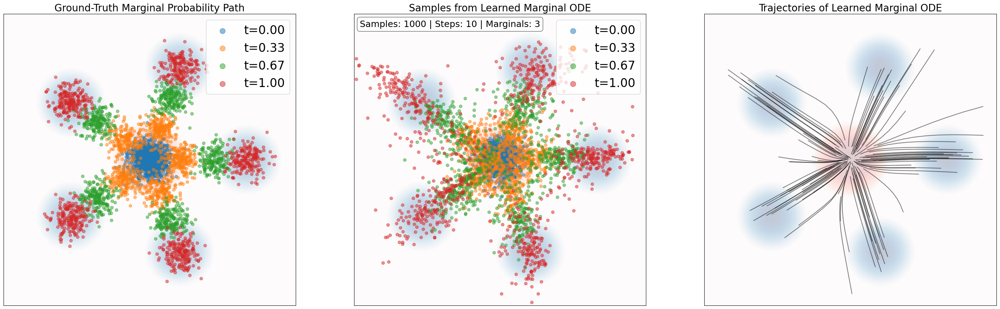

In [ ]:
#######################
# Change these values #
#######################
num_samples = 1000
num_timesteps = 10
num_marginals = 3


##############
# Setup Plot #
##############

scale = PARAMS["scale"]
x_bounds = [-scale,scale]
y_bounds = [-scale,scale]
legend_size=24
markerscale=1.8

# Setup figure
fig, axes = plt.subplots(1,3, figsize=(36, 12))

###########################################
# Graph Samples from Learned Marginal ODE #
###########################################
ax = axes[1]

ax.set_xlim(*x_bounds)
ax.set_ylim(*y_bounds)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title("Samples from Learned Marginal ODE", fontsize=20)

# Plot source and target
imshow_density(density=p_simple, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Reds'))
imshow_density(density=p_data, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Blues'))


# Construct integrator and plot trajectories
ode = LearnedVectorFieldODE(flow_model)
simulator = EulerSimulator(ode)
x0 = path.p_simple.sample(num_samples) # (num_samples, 2)
ts = torch.linspace(0.0, 1.0, num_timesteps).view(1,-1,1).expand(num_samples,-1,1).to(device) # (num_samples, nts, 1)
xts = simulator.simulate_with_trajectory(x0, ts) # (bs, nts, dim)

# Add experiment parameters as text to the middle plot
param_text = f"Samples: {num_samples} | Steps: {num_timesteps} | Marginals: {num_marginals}"
ax.text(
    0.02, 0.98, param_text,
    transform=ax.transAxes, fontsize=18,
    verticalalignment='top', horizontalalignment='left',
    bbox=dict(boxstyle='round', facecolor='white', alpha=0.6)
)


# Extract every n-th integration step to plot
every_n = record_every(num_timesteps=num_timesteps, record_every=num_timesteps // num_marginals)
xts_every_n = xts[:,every_n,:] # (bs, nts // n, dim)
ts_every_n = ts[0,every_n] # (nts // n,)
for plot_idx in range(xts_every_n.shape[1]):
    tt = ts_every_n[plot_idx].item()
    ax.scatter(xts_every_n[:,plot_idx,0].detach().cpu(), xts_every_n[:,plot_idx,1].detach().cpu(), marker='o', alpha=0.5, label=f't={tt:.2f}')

ax.legend(prop={'size': legend_size}, loc='upper right', markerscale=markerscale)

##############################################
# Graph Trajectories of Learned Marginal ODE #
##############################################
ax = axes[2]
ax.set_title("Trajectories of Learned Marginal ODE", fontsize=20)
ax.set_xlim(*x_bounds)
ax.set_ylim(*y_bounds)
ax.set_xticks([])
ax.set_yticks([])

# Plot source and target
imshow_density(density=p_simple, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Reds'))
imshow_density(density=p_data, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Blues'))

for traj_idx in range(num_samples // 10):
    ax.plot(xts[traj_idx,:,0].detach().cpu(), xts[traj_idx,:,1].detach().cpu(), alpha=0.5, color='black')

################################################
# Graph Ground-Truth Marginal Probability Path #
################################################
ax = axes[0]
ax.set_title("Ground-Truth Marginal Probability Path", fontsize=20)
ax.set_xlim(*x_bounds)
ax.set_ylim(*y_bounds)
ax.set_xticks([])
ax.set_yticks([])

for plot_idx in range(xts_every_n.shape[1]):
    tt = ts_every_n[plot_idx].unsqueeze(0).expand(num_samples, 1)
    marginal_samples = path.sample_marginal_path(tt)
    ax.scatter(marginal_samples[:,0].detach().cpu(), marginal_samples[:,1].detach().cpu(), marker='o', alpha=0.5, label=f't={tt[0,0].item():.2f}')

# Plot source and target
imshow_density(density=p_simple, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Reds'))
imshow_density(density=p_data, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Blues'))

ax.legend(prop={'size': legend_size}, loc='upper right', markerscale=markerscale)
    
plt.show()

Base
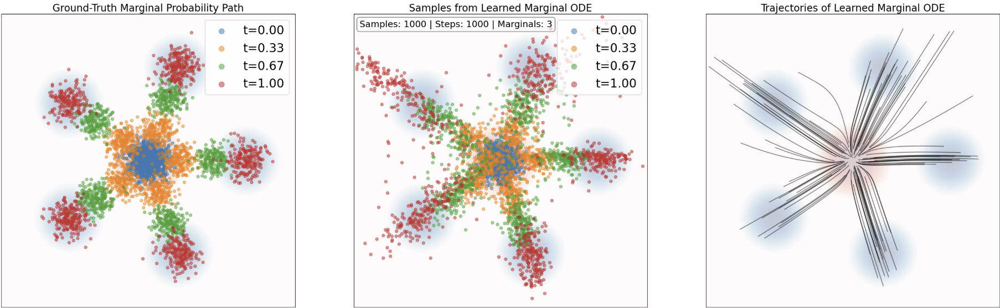

![Screenshot 2025-08-08 112937.png](<attachment:Screenshot 2025-08-08 112937.png>) ![Screenshot 2025-08-08 112926.png](<attachment:Screenshot 2025-08-08 112926.png>) ![Screenshot 2025-08-08 112917.png](<attachment:Screenshot 2025-08-08 112917.png>) ![Screenshot 2025-08-08 112909.png](<attachment:Screenshot 2025-08-08 112909.png>) ![Screenshot 2025-08-08 112900.png](<attachment:Screenshot 2025-08-08 112900.png>) ![Screenshot 2025-08-08 112849.png](<attachment:Screenshot 2025-08-08 112849.png>)
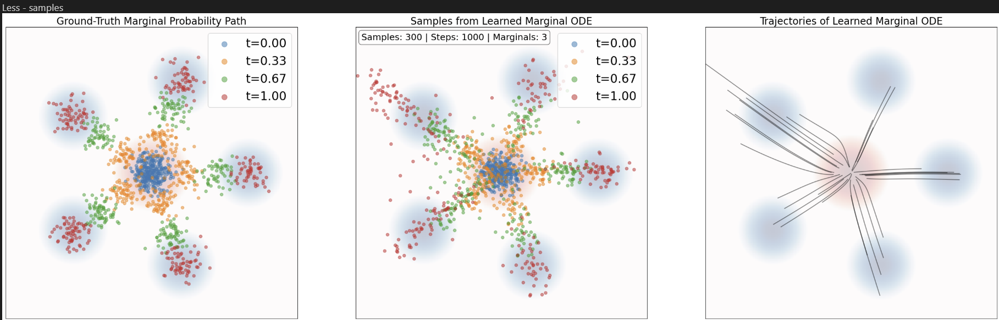
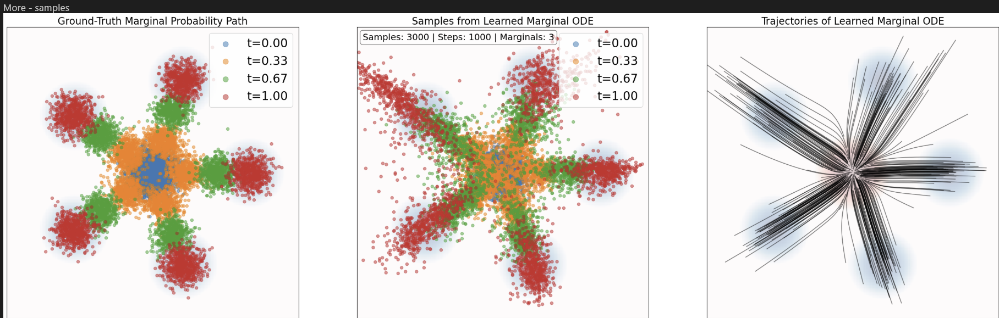
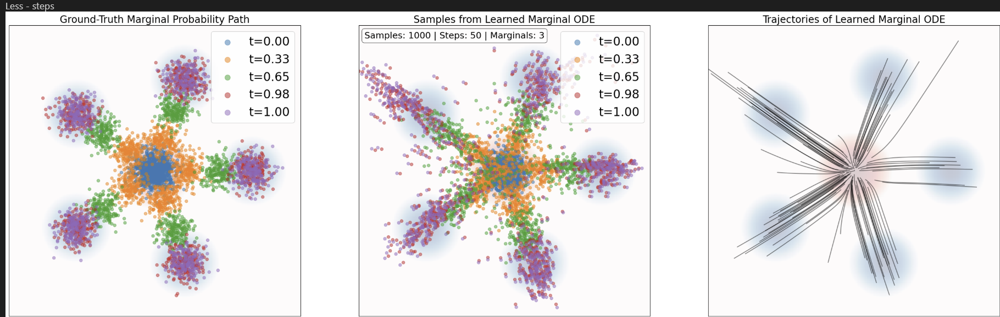
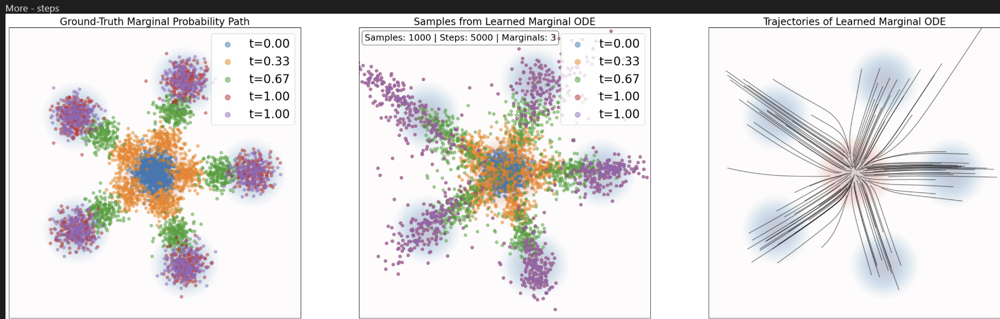
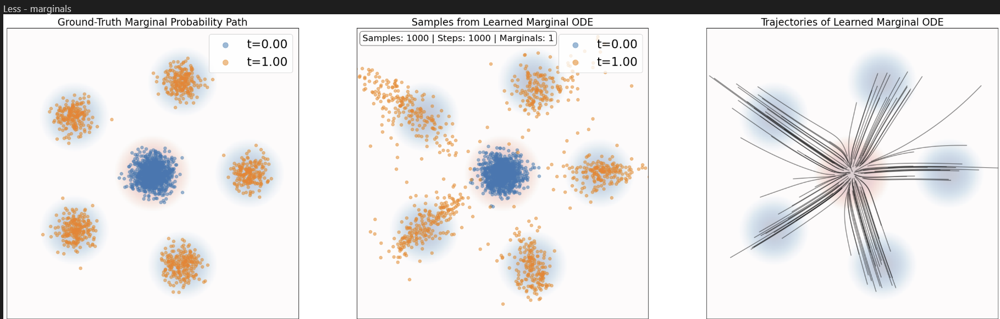
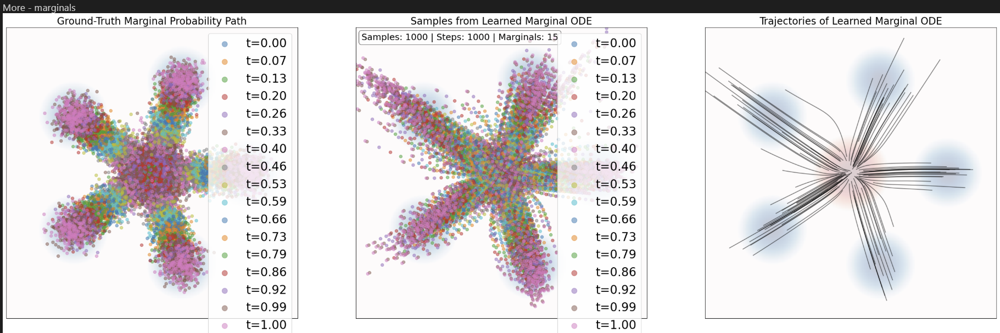

### Problem 3.2: Score Matching with Gaussian Conditional Probability Paths

We have thus far used flow matching to train a model $u_t^{\theta}(x) \approx u_t^{\text{ref}}$ so that $$d X_t = u_t^{\theta}(X_t) dt $$ approximately passes through the desired marginal probability path $p_t(x)$. Now recall from lecture that we may augment the reference marginal vector field $u_t^{\text{ref}}(x)$ with *Langevin dynamics* to add stochasticity while preserving the marginals, viz., $$dX_t = \left[u_t^{\text{ref}}(x) + \frac{1}{2}\sigma^2 \nabla \log p_t(x)\right] dt + \sigma d W_t.$$
Substituting our learned approximation $u_t^{\theta}(x) \approx u_t^{\text{ref}}$ therefore yields 
$$dX_t = \left[u_t^{\theta}(x) + \frac{1}{2}\sigma^2 \nabla \log p_t(x)\right] dt + \sigma d W_t.$$
There's just one issue, what's the marginal score $\nabla \log p_t(x)$? In Question 2.3, we computed the conditional score $\nabla \log p_t(x|z)$ of the Gaussian probability path. In the same way that we learned an approximation $u_t^{\theta}(x) \approx u_t^{\text{ref}}$, we'd like to be able to learn a similar approximation $s_t^{\theta}(x) \approx \nabla \log p_t(x)$. Recall from lecture the identity $$\nabla \log p_t(x) = \mathbb{E}_{z \sim p_t(z|x)}\left[\nabla \log p_t(x|z) \right].$$ It then immediately follows that
$$\nabla \log p_t(x) = \text{argmin}_{s_t(x)} \,\,\mathbb{E}_{z \sim p(z), x \sim p_t(x|z)} \left[\lVert s_t(x) - \nabla \log p_t(x|z)\rVert^2\right].$$
We thus obtain the **conditional score matching** loss
$$\mathcal{L}_{\text{CSM}}(\theta) \triangleq \mathbb{E}_{t \sim \mathcal{U}[0,1), z \sim p(z), x \sim p_t(x|z)} \left[\lVert s_t^{\theta}(x) - \nabla \log p_t(x|z)\rVert^2\right].$$
Here, we will parameterize $s_t^{\theta}(x): \mathbb{R}^2 \to \mathbb{R}^2$ as a simple MLP, just like $u_t^{\theta}(x)$.

**Your job**: Fill in method `ConditionalScoreMatchingTrainer.get_train_loss` to implement the conditional score matching loss $\mathcal{L}_{\text{CSM}}(\theta)$.

**Hint:** Remember to re-use your implementation of `GaussianConditionalProbabilityPath.conditional_score`!

In [ ]:
class MLPScore(torch.nn.Module):
    """
    MLP-parameterization of the learned score field
    """
    def __init__(self, dim: int, hiddens: List[int]):
        super().__init__()
        self.dim = dim
        self.net = build_mlp([dim + 1] + hiddens + [dim])

    def forward(self, x: torch.Tensor, t: torch.Tensor):
        """
        Args:
        - x: (bs, dim)
        Returns:
        - s_t^theta(x): (bs, dim)
        """
        xt = torch.cat([x,t], dim=-1)
        return self.net(xt)        
        
class ConditionalScoreMatchingTrainer(Trainer):
    def __init__(self, path: ConditionalProbabilityPath, model: MLPScore, **kwargs):
        super().__init__(model, **kwargs)
        self.path = path

    def get_train_loss(self, batch_size: int) -> torch.Tensor:
        """
        Computes the training loss for the conditional score matching task.
        Args:
            - batch_size: the number of samples in the batch
        Returns:
            - loss: the training loss, a scalar tensor
        """
        # Sample conditioning variable z
        z = self.path.p_data.sample(batch_size)
        # Sample time t uniformly in [0,1)
        t = torch.rand(batch_size, 1)
        t = t.to(z.device)
        # Sample x ~ p_t(x|z)
        x = self.path.sample_conditional_path(z, t)

        # Compute the score s_t^theta(x)
        # Note: We need to concatenate x and t along the last dimension
        s_t_theta = self.model(x, t)
        s_t_ref = self.path.conditional_score(x, z, t)

        # Compute the loss
        loss = torch.mean((s_t_theta - s_t_ref) ** 2)
        return loss
        raise NotImplementedError("Fill me in for Question 3.2!")

Now let's train! **Remember, the loss should converge, but not to zero!**

In [ ]:
# Construct conditional probability path
path = GaussianConditionalProbabilityPath(
    p_data = GaussianMixture.symmetric_2D(nmodes=5, std=PARAMS["target_std"], scale=PARAMS["target_scale"]).to(device), 
    alpha = LinearAlpha(),
    beta = SquareRootBeta()
).to(device)

# Construct learnable vector field
score_model = MLPScore(dim=2, hiddens=[64,64,64,64])

# Construct trainer
trainer = ConditionalScoreMatchingTrainer(path, score_model)
losses = trainer.train(num_epochs=10000, device=device, lr=1e-3, batch_size=1000)

Epoch 9999, loss: 5.73416805267334: : 10000it [00:30, 330.16it/s] 


Now let's visualize our work! Before we do however, we'll need to wrap our learned our flow model and score model in an instance of `SDE` so that we can integrate it using our `EulerMaruyamaIntegrator` class. This new class, `LangevinFlowSDE` will correspond to the dynamics $$dX_t = \left[u_t^{\theta}(x) + \frac{1}{2}\sigma^2 s_t^{\theta}(x)\right] dt + \sigma d W_t.$$

In [ ]:
class LangevinFlowSDE(SDE):
    def __init__(self, flow_model: MLPVectorField, score_model: MLPScore, sigma: float):
        """
        Args:
        - path: the ConditionalProbabilityPath object to which this vector field corresponds
        - z: the conditioning variable, (1, dim)
        """
        super().__init__()
        self.flow_model = flow_model
        self.score_model = score_model
        self.sigma = sigma

    def drift_coefficient(self, x: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Args:
            - x: state at time t, shape (bs, dim)
            - t: time, shape (bs,.)
        Returns:
            - u_t(x|z): shape (batch_size, dim)
        """
        return self.flow_model(x,t) + 0.5 * self.sigma ** 2 * self.score_model(x, t)

    def diffusion_coefficient(self, x: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Args:
            - x: state at time t, shape (bs, dim)
            - t: time, shape (bs,.)
        Returns:
            - u_t(x|z): shape (batch_size, dim)
        """
        return self.sigma * torch.randn_like(x)

100%|██████████| 9/9 [00:00<00:00, 1756.00it/s]

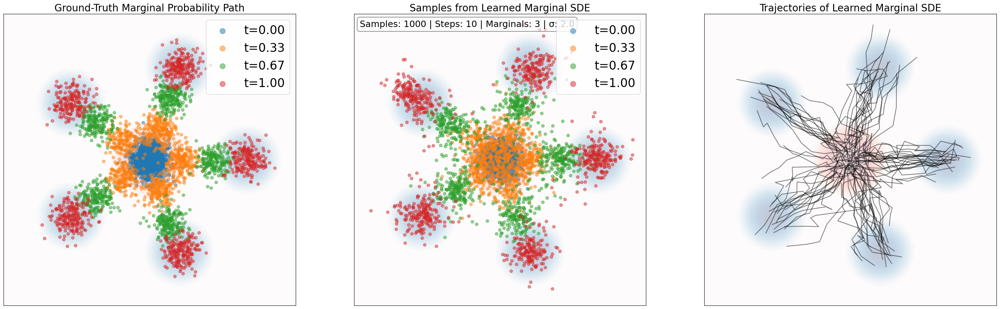

In [ ]:
#######################
# Change these values #
#######################
num_samples = 1000
num_timesteps = 10
num_marginals = 3
sigma = 2.0 # Don't set sigma too large or you'll get numerical issues!


##############
# Setup Plot #
##############

scale = PARAMS["scale"]
x_bounds = [-scale,scale]
y_bounds = [-scale,scale]
legend_size = 24
markerscale = 1.8

# Setup figure
fig, axes = plt.subplots(1,3, figsize=(36, 12))

###########################################
# Graph Samples from Learned Marginal SDE #
###########################################
ax = axes[1]
ax.set_title("Samples from Learned Marginal SDE", fontsize=20)
ax.set_xlim(*x_bounds)
ax.set_ylim(*y_bounds)
ax.set_xticks([])
ax.set_yticks([])

# Plot source and target
imshow_density(density=path.p_simple, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Reds'))
imshow_density(density=path.p_data, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Blues'))


# Construct integrator and plot trajectories
sde = LangevinFlowSDE(flow_model, score_model, sigma)
simulator = EulerMaruyamaSimulator(sde)
x0 = path.p_simple.sample(num_samples) # (num_samples, 2)
ts = torch.linspace(0.0, 1.0, num_timesteps).view(1,-1,1).expand(num_samples,-1,1).to(device) # (num_samples, nts, 1)
xts = simulator.simulate_with_trajectory(x0, ts) # (bs, nts, dim)

# Extract every n-th integration step to plot
every_n = record_every(num_timesteps=num_timesteps, record_every=num_timesteps // num_marginals)
xts_every_n = xts[:,every_n,:] # (bs, nts // n, dim)
ts_every_n = ts[0,every_n] # (nts // n,)
for plot_idx in range(xts_every_n.shape[1]):
    tt = ts_every_n[plot_idx].item()
    ax.scatter(xts_every_n[:,plot_idx,0].detach().cpu(), xts_every_n[:,plot_idx,1].detach().cpu(), marker='o', alpha=0.5, label=f't={tt:.2f}')

ax.legend(prop={'size': legend_size}, loc='upper right', markerscale=markerscale)

# Add experiment parameters as text to the middle plot
param_text = f"Samples: {num_samples} | Steps: {num_timesteps} | Marginals: {num_marginals} | σ: {sigma}"
ax.text(
    0.02, 0.98, param_text,
    transform=ax.transAxes, fontsize=18,
    verticalalignment='top', horizontalalignment='left',
    bbox=dict(boxstyle='round', facecolor='white', alpha=0.6)
)


###############################################
# Graph Trajectories of Learned Marginal SDE  #
###############################################
ax = axes[2]
ax.set_title("Trajectories of Learned Marginal SDE", fontsize=20)
ax.set_xlim(*x_bounds)
ax.set_ylim(*y_bounds)
ax.set_xticks([])
ax.set_yticks([])

# Plot source and target
imshow_density(density=path.p_simple, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Reds'))
imshow_density(density=path.p_data, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Blues'))

for traj_idx in range(num_samples // 10):
    ax.plot(xts[traj_idx,:,0].detach().cpu(), xts[traj_idx,:,1].detach().cpu(), alpha=0.5, color='black')

################################################
# Graph Ground-Truth Marginal Probability Path #
################################################
ax = axes[0]
ax.set_title("Ground-Truth Marginal Probability Path", fontsize=20)
ax.set_xlim(*x_bounds)
ax.set_ylim(*y_bounds)
ax.set_xticks([])
ax.set_yticks([])

for plot_idx in range(xts_every_n.shape[1]):
    tt = ts_every_n[plot_idx].unsqueeze(0).expand(num_samples, 1)
    marginal_samples = path.sample_marginal_path(tt)
    ax.scatter(marginal_samples[:,0].detach().cpu(), marginal_samples[:,1].detach().cpu(), marker='o', alpha=0.5, label=f't={tt[0,0].item():.2f}')

# Plot source and target
imshow_density(density=path.p_simple, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Reds'))
imshow_density(density=path.p_data, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Blues'))

ax.legend(prop={'size': legend_size}, loc='upper right', markerscale=markerscale)
    
plt.show()

![Screenshot 2025-08-08 113151.png](<attachment:Screenshot 2025-08-08 113151.png>) ![Screenshot 2025-08-08 113143.png](<attachment:Screenshot 2025-08-08 113143.png>) ![Screenshot 2025-08-08 113135.png](<attachment:Screenshot 2025-08-08 113135.png>) ![Screenshot 2025-08-08 113128.png](<attachment:Screenshot 2025-08-08 113128.png>) ![Screenshot 2025-08-08 113113.png](<attachment:Screenshot 2025-08-08 113113.png>) ![Screenshot 2025-08-08 113106.png](<attachment:Screenshot 2025-08-08 113106.png>) ![Screenshot 2025-08-08 113100.png](<attachment:Screenshot 2025-08-08 113100.png>) ![Screenshot 2025-08-08 113053.png](<attachment:Screenshot 2025-08-08 113053.png>)
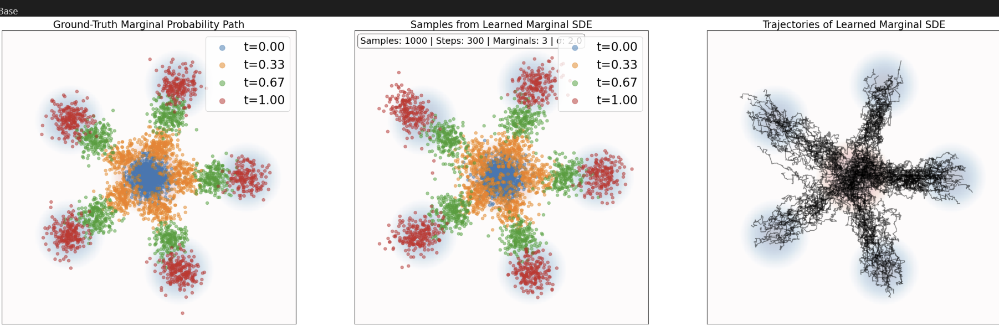
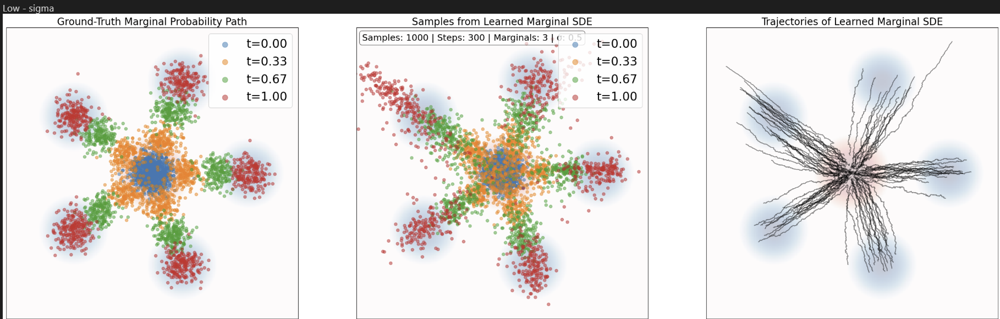
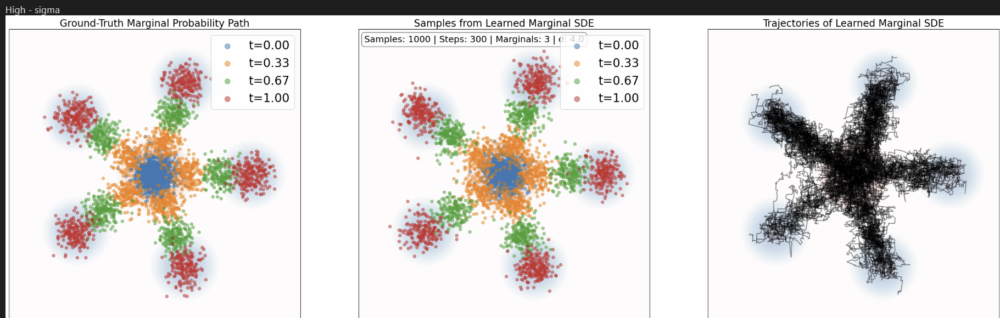
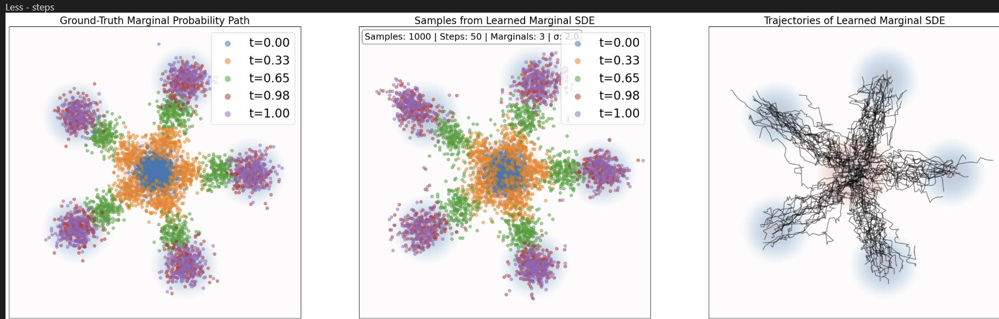
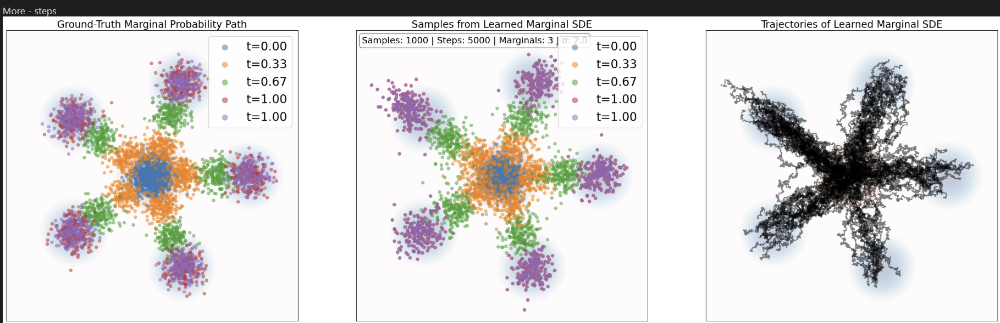
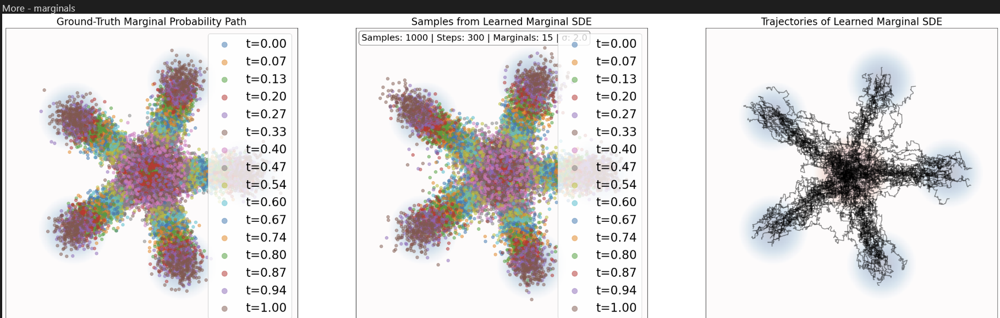
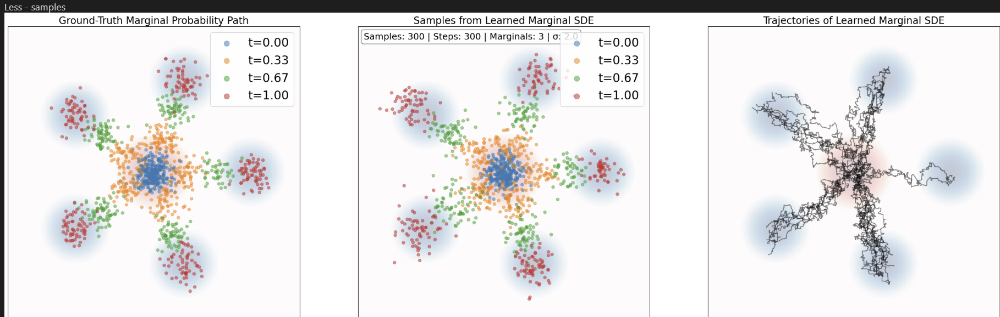
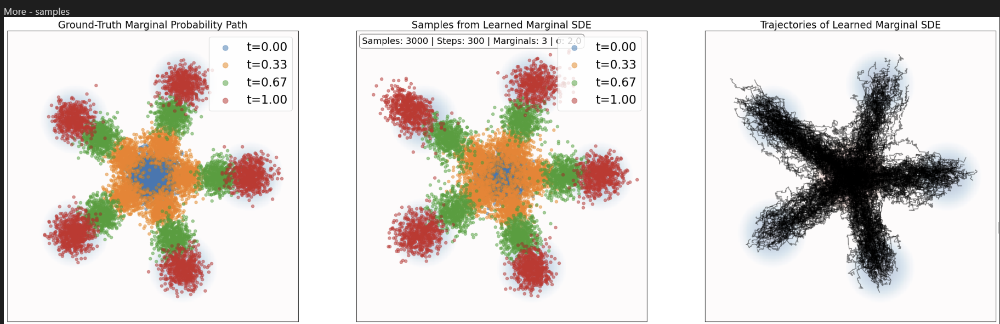

### Question 3.3: Deriving the Marginal Score from the Marginal Flow
Recall from the notes and the lecture that for Gaussian probability paths $$u_t^{\text{ref}}(x) = a_tx + b_t\nabla \log p_t^{\text{ref}}(x).$$

where $(a_t, b_t) = \left(\frac{\dot{\alpha}_t}{\alpha_t}, \beta_t^2 \frac{\dot{\alpha}_t}{\alpha_t} - \dot{\beta}_t \beta_t\right)$. Rearranging yields $$\nabla \log p_t^{\text{ref}}(x) = \frac{u_t^{\text{ref}}(x) - a_tx}{b_t}.$$

Therefore, we may instead exploit the fact that we have already trained $u_t^{\theta}(x)$, to parameterize $s_t^{\theta}(x)$ via
$$\tilde{s}_t^{\theta}(x) = \frac{u_t^{\theta}(x) - a_tx}{b_t} = \frac{\alpha_t u_t^{\theta}(x) - \dot{\alpha}_t x}{\beta_t^2 \dot{\alpha}_t - \alpha_t \dot{\beta}_t \beta_t},$$
so long as $\beta_t^2 \dot{\alpha}_t - \alpha_t \dot{\beta}_t \beta_t \neq 0$ (which is true for $t \in [0,1)$ by monotonicity). Here, we differentiate $\tilde{s}_t^{\theta}(x)$ paramterized via $u_t^{\theta}(x)$ from $s_t^{\theta}(x)$ learned indepedently using score matching. Plugging in $\alpha_t = t$ and $\beta_t = \sqrt{1-t}$, we find that $$\beta_t^2 \dot{\alpha}_t - \alpha_t \dot{\beta}_t \beta_t = \begin{cases} 1 - \frac{t}{2} & \text{if}\,\,t\in [0,1)\\0 & \text{if}\,\,{t=1}. \end{cases}.$$ In the following visualization, we'll circumvent the issue at $t=1.0$ by taking $t=1 - \varepsilon$ in place of $t=1$, for small $\varepsilon \approx 0$.

**Your job**: Implement $\tilde{s}_t^{\theta}(x)$ by filling in the body of `ScoreFromVectorField.forward` below. The next several cells generate a visualization comparing the flow-parameterized score $\tilde{s}_t^{\theta}(x)$ to our independently learned score $s_t^{\theta}(x)$. You can check that your implementation is correct by making sure that the visualizations match.

In [ ]:
class ScoreFromVectorField(torch.nn.Module):
    """
    Parameterization of score via learned vector field (for the special case of a Gaussian conditional probability path)
    """
    def __init__(self, vector_field: MLPVectorField, alpha: Alpha, beta: Beta):
        super().__init__()
        self.vector_field = vector_field
        self.alpha = alpha
        self.beta = beta

    def forward(self, x: torch.Tensor, t: torch.Tensor):
        """
        Args:
        - x: (bs, dim)
        Returns:
        - score: (bs, dim)
        """
        # Compute the drift coefficient u_t^theta(x)
        u_t_theta = self.vector_field(x, t)

        # Compute the alpha and beta coefficients
        alpha_t = self.alpha(t)
        eps = 1e-6

        # Compute the score s_t^theta(x) using the formula:
        # s^~_t^theta(x) = (u_t^theta(x) - a_t * x) / b_t
        #                = (alpha_t * u_t^theta(x) - alpha_dot_t * x) / ((beta_t ** 2) * alpha_dot_t - alpha_t * beta_dot_t * beta_t)
        #                = (alpha_t * u_t_theta(x) - x) / (1 - t /2)
        # Since we are using a Gaussian conditional probability path and a = t, b = (1 - t) ** 1/2, we can use the formula:
        # (beta_t ** 2) * alpha_dot_t - alpha_t * beta_dot_t * beta_t = 1 - t / 2
        score = (alpha_t * u_t_theta - x) / (1 - t / 2 + eps)  # Add eps to avoid division by zero
        return score
        raise NotImplementedError("Fill me in for Question 3.3!")   

Now, let's compare our learned marginal score $s_t^{\theta}(x)$ (an instance of `MLPScore`) to our flow-parameterized score (an instance of `ScoreFromVectorField`). We'll do so by plotting the vector fields across time and space.

**Note**: The two score parameterizations will probably look a bit different, but should generally point in the same direction, especially around modes. To sanity check your output, you may consult Figure 10 from the lecture notes.

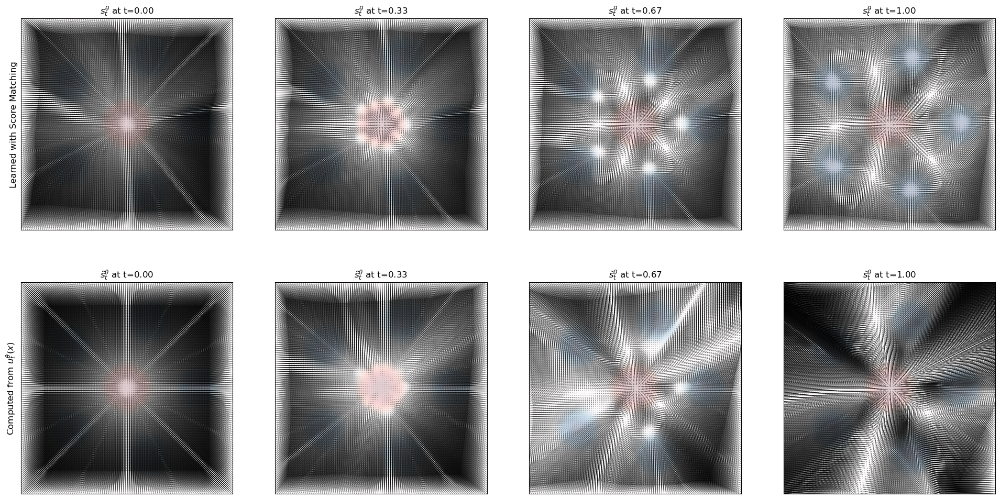

In [ ]:
#######################
# Change these values #
#######################
num_bins = 100
num_marginals = 4

##############################
# Construct probability path #
##############################
path = GaussianConditionalProbabilityPath(
    p_data = GaussianMixture.symmetric_2D(nmodes=5, std=PARAMS["target_std"], scale=PARAMS["target_scale"]).to(device), 
    alpha = LinearAlpha(),
    beta = SquareRootBeta()
).to(device)

#########################
# Define score networks #
#########################
learned_score_model = score_model
flow_score_model = ScoreFromVectorField(flow_model, path.alpha, path.beta)


###############################
# Plot score fields over time #
###############################
fig, axes = plt.subplots(2, num_marginals, figsize=(6 * num_marginals, 12))
axes = axes.reshape((2, num_marginals))

scale = PARAMS["scale"]
ts = torch.linspace(0.0, 0.9999, num_marginals).to(device)
xs = torch.linspace(-scale, scale, num_bins).to(device)
ys = torch.linspace(-scale, scale, num_bins).to(device)
xx, yy = torch.meshgrid(xs, ys)
xx = xx.reshape(-1,1)
yy = yy.reshape(-1,1)
xy = torch.cat([xx,yy], dim=-1)

axes[0,0].set_ylabel("Learned with Score Matching", fontsize=12)
axes[1,0].set_ylabel("Computed from $u_t^{{\\theta}}(x)$", fontsize=12)
for idx in range(num_marginals):
    t = ts[idx]
    bs = num_bins ** 2
    tt = t.view(1,1).expand(bs, 1)
    
    # Learned scores
    learned_scores = learned_score_model(xy, tt)
    learned_scores_x = learned_scores[:,0]
    learned_scores_y = learned_scores[:,1]

    ax = axes[0, idx]
    ax.quiver(xx.detach().cpu(), yy.detach().cpu(), learned_scores_x.detach().cpu(), learned_scores_y.detach().cpu(), scale=125, alpha=0.5)
    imshow_density(density=path.p_simple, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Reds'))
    imshow_density(density=path.p_data, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Blues'))
    ax.set_title(f'$s_{{t}}^{{\\theta}}$ at t={t.item():.2f}')
    ax.set_xticks([])
    ax.set_yticks([])
    

    # Flow score model
    ax = axes
    flow_scores = flow_score_model(xy,tt)
    flow_scores_x = flow_scores[:,0]
    flow_scores_y = flow_scores[:,1]

    ax = axes[1, idx]
    ax.quiver(xx.detach().cpu(), yy.detach().cpu(), flow_scores_x.detach().cpu(), flow_scores_y.detach().cpu(), scale=125, alpha=0.5)
    imshow_density(density=path.p_simple, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Reds'))
    imshow_density(density=path.p_data, x_bounds=x_bounds, y_bounds=y_bounds, bins=200, ax=ax, vmin=-10, alpha=0.25, cmap=plt.get_cmap('Blues'))
    ax.set_title(f'$\\tilde{{s}}_{{t}}^{{\\theta}}$ at t={t.item():.2f}')
    ax.set_xticks([])
    ax.set_yticks([])

# # Add experiment parameters as global annotation (left-top corner)
# param_text = f"Bins: {num_bins} | Marginals: {num_marginals}"
# fig.text(
#     0.01, 0.97, param_text,
#     fontsize=16, ha='left', va='top',
#     bbox=dict(boxstyle='round', facecolor='white', alpha=0.6)
# )


![Screenshot 2025-08-08 113338.png](<attachment:Screenshot 2025-08-08 113338.png>) ![Screenshot 2025-08-08 113330.png](<attachment:Screenshot 2025-08-08 113330.png>) ![Screenshot 2025-08-08 113315.png](<attachment:Screenshot 2025-08-08 113315.png>) ![Screenshot 2025-08-08 113259.png](<attachment:Screenshot 2025-08-08 113259.png>)

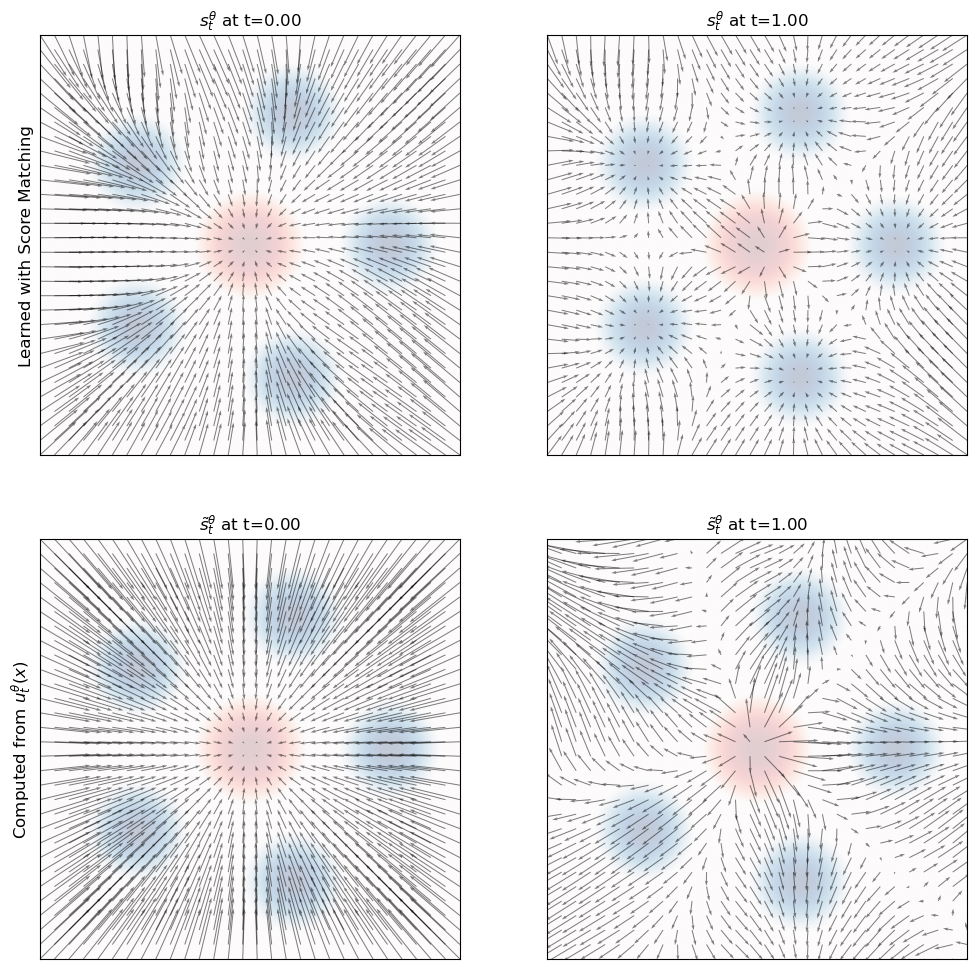
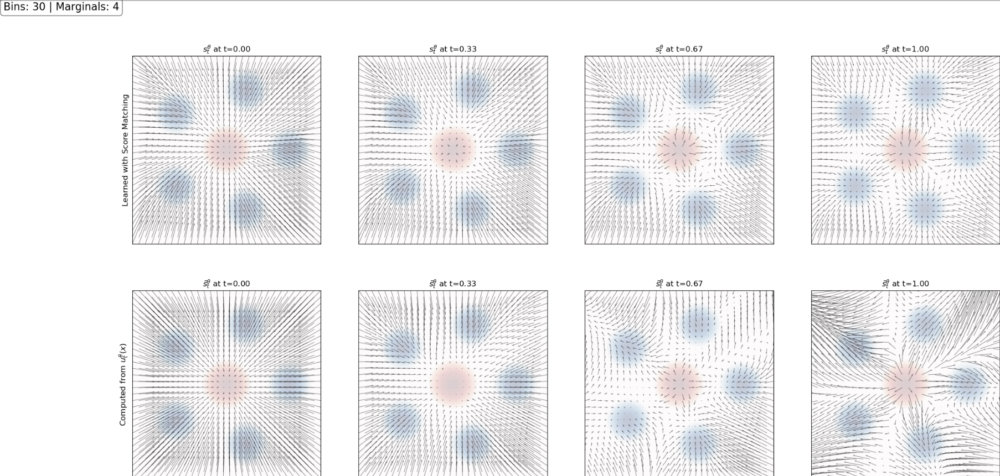
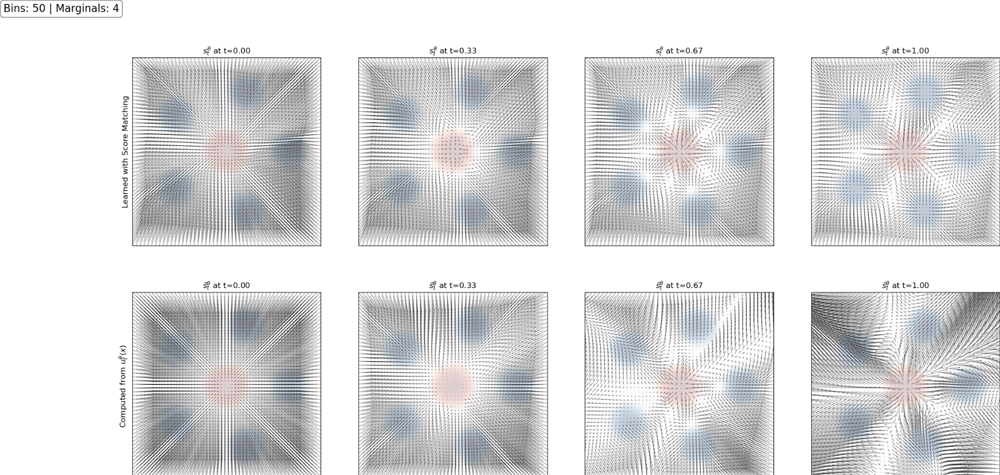
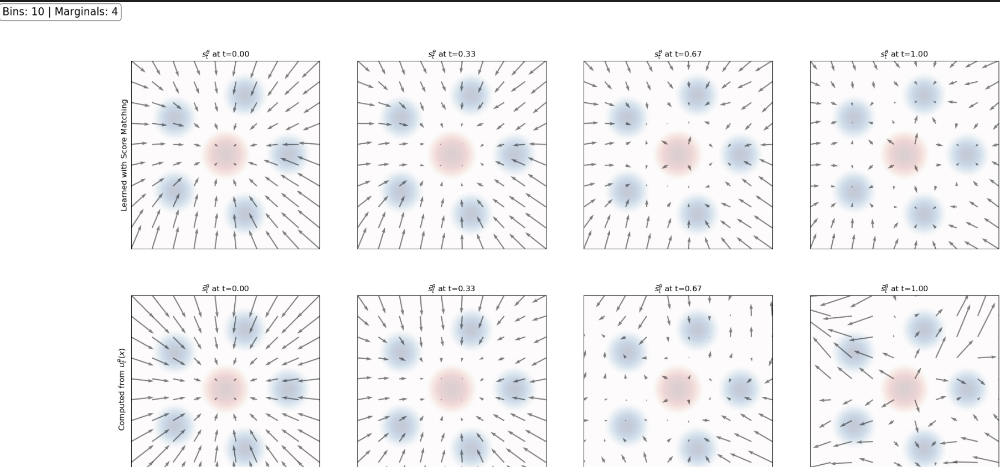
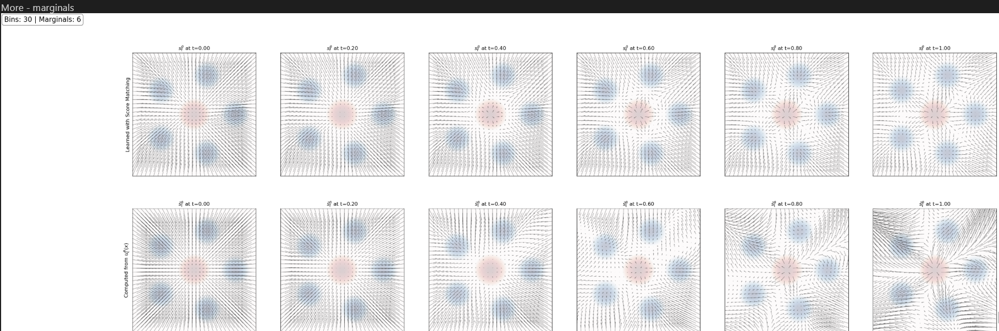